In [ ]:
!wget https://github.com/deel-ai/Craft/raw/refs/heads/main/assets/rabbit.npz
!pip install -q timm einops

--2024-10-24 14:19:39--  https://github.com/deel-ai/Craft/raw/refs/heads/main/assets/rabbit.npz
Resolving github.com (github.com)... 20.205.243.166
Connecting to github.com (github.com)|20.205.243.166|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/deel-ai/Craft/refs/heads/main/assets/rabbit.npz [following]
--2024-10-24 14:19:40--  https://raw.githubusercontent.com/deel-ai/Craft/refs/heads/main/assets/rabbit.npz
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.108.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 45158664 (43M) [application/octet-stream]
Saving to: ‘rabbit.npz.2’

rabbit.npz.2        100%[===================>]  43.07M  --.-KB/s    in 0.1s    

2024-10-24 14:19:45 (368 MB/s) - ‘rabbit.npz.2’ saved [45158664/45158664]



In [ ]:
import torch
from sklearn.decomposition import NMF
import torchvision
import timm
import matplotlib.pyplot as plt
from tqdm import tqdm
from math import ceil

def set_size(w,h):
  """Set matplot figure size"""
  plt.rcParams["figure.figsize"] = [w,h]

def show(img, norm=True, **kwargs):
  """ Display torch/tf tensor """
  if isinstance(img, torch.Tensor):
    img = img.detach().cpu().numpy()
  img = np.array(img, dtype=np.float32)

  # check if channel first
  if img.shape[0] == 1:
    img = img[0]
  if img.shape[0] == 3:
    img = np.moveaxis(img, 0, 2)
  # check if cmap
  if img.shape[-1] == 1:
    img = img[:,:,0]
  # normalize
  if norm:
    img -= img.min(); img/=img.max()

  plt.imshow(img, **kwargs)
  plt.axis('off')
  plt.grid(None)

def batcher(elements, batch_size):
  for batch_id in tqdm(range(int(ceil(len(elements) / batch_size))), disable=True):
    chunk = elements[(batch_id)*batch_size:(batch_id+1)*batch_size]
    yield chunk

In [ ]:
from timm.data import resolve_data_config
from timm.data.transforms_factory import create_transform
from torchvision import transforms

model_name = 'resnet50'

model = timm.create_model(model_name, pretrained=True)
model.eval()
model.to('cuda')

config = resolve_data_config({}, model=model)
transform = create_transform(**config)

torch.Size([300, 3, 224, 224])

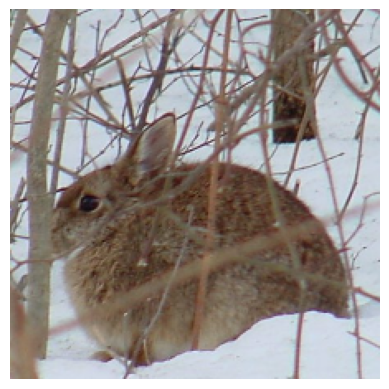

In [ ]:
import numpy as np
from einops import rearrange

Imgs = np.load('rabbit.npz', allow_pickle=True)['arr_0'].astype(np.uint8)
X = torch.tensor(Imgs)
X = rearrange(X, 'n h w c -> n c h w')

show(X[0])

X.shape

In [ ]:
# get feature of the model
X = torch.tensor(X).to('cuda')
X = X / X.max()

A = []
for batch in batcher(X, 32):
  batch = transform(batch)
  batch_A = model.forward_features(batch)
  A.append(batch_A.detach().cpu().numpy())

A = np.concatenate(A, axis=0)
A.shape

<ipython-input-69-3d80be9d7e78>:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  X = torch.tensor(X).to('cuda')


(300, 2048, 7, 7)

In [ ]:
nmf = NMF(10)

A_flatten = rearrange(A, 'n c h w -> (n h w) c')

Z = nmf.fit_transform(A_flatten)
D = nmf.components_

Z_heatmaps = rearrange(Z, '(n h w) r -> n h w r', n=len(X), h=11, w=11)
Z_heatmaps.shape

In [ ]:
Z.shape

(14700, 10)

(300, 7, 7, 10)

In [ ]:
import cv2
from skimage import measure
import matplotlib.colors as mcolors


all_cmaps = []

def get_alpha_cmap(rgb_color):
    # Normalize the RGB color values to the range [0, 1]
    rgb_color = np.array(rgb_color) / 255.0

    # Create an alpha colormap with varying alpha values
    cmap_data = {'red':   [(0, rgb_color[0], rgb_color[0]),
                           (1, rgb_color[0], rgb_color[0])],
                 'green': [(0, rgb_color[1], rgb_color[1]),
                           (1, rgb_color[1], rgb_color[1])],
                 'blue':  [(0, rgb_color[2], rgb_color[2]),
                           (1, rgb_color[2], rgb_color[2])],
                 'alpha': [(0, 0, 0),
                           (1, 1, 1)]}

    alpha_cmap = mcolors.LinearSegmentedColormap('alpha_cmap', cmap_data, N=256)

    all_cmaps.append(alpha_cmap)

    return alpha_cmap

slack_blue  = get_alpha_cmap((54, 197, 240))
slack_green = get_alpha_cmap((46, 182, 125) )
slack_red   = get_alpha_cmap((210, 40, 95))
slack_yellow = get_alpha_cmap((236, 178, 46))
slack_violet = get_alpha_cmap((84, 25, 85))

google_blue = get_alpha_cmap((66, 133, 244))
google_red = get_alpha_cmap((219, 68, 55))
google_yellow= get_alpha_cmap((244, 180, 0))
google_green = get_alpha_cmap((15, 157, 88))

deep_purple = get_alpha_cmap((103, 58, 183))
pink = get_alpha_cmap((236, 64, 122))
anthracite = get_alpha_cmap((13, 13, 21))

palette_1 = get_alpha_cmap((33, 115, 174))
palette_2 = get_alpha_cmap((216, 146, 49))
palette_3 = get_alpha_cmap((58, 155, 118))
palette_4 = get_alpha_cmap((210, 158, 201))

cmaps = [google_blue, slack_green, slack_red, slack_yellow, slack_violet, anthracite, google_blue, pink, deep_purple]


def create_alpha_cmap(color_input, name=None):
    if isinstance(color_input, str):
        # If the input is a colormap name
        base_cmap = plt.cm.get_cmap(color_input)
    elif isinstance(color_input, tuple) and len(color_input) == 3:
        if np.max(color_input) > 1:
            color_input = (
                color_input[0] / 255,
                color_input[1] / 255,
                color_input[2] / 255,
            )
        if name is None:
            name = f'RGB{color_input}'
        base_cmap = mcolors.LinearSegmentedColormap.from_list(name, [color_input, color_input])
    else:
        raise ValueError("Invalid color_input. Must be a colormap name or an RGB tuple.")

    # alpha values ranging from 0 to 1
    # tfel: useful to start above zero?
    alpha = np.linspace(0.0, 1, base_cmap.N)

    colors = base_cmap(np.arange(base_cmap.N))
    colors[:, -1] = alpha

    alpha_cmap = mcolors.LinearSegmentedColormap.from_list('alpha_cmap', colors)

    return alpha_cmap


# predefine some alpha cmaps
JET_ALPHA = create_alpha_cmap('jet')
VIRIDIS_ALPHA = create_alpha_cmap('viridis')

_tab_10_colors = [
    (31, 119, 180),   # tab:blue
    (255, 127, 14),   # tab:orange
    (44, 160, 44),    # tab:green
    (214, 39, 40),    # tab:red
    (148, 103, 189),  # tab:purple
    (140, 86, 75),    # tab:brown
    (227, 119, 194),  # tab:pink
    (127, 127, 127),  # tab:gray
    (188, 189, 34),   # tab:olive
    (23, 190, 207)    # tab:cyan
]

TAB10_ALPHA = [create_alpha_cmap(color) for color in _tab_10_colors]

cmaps = [google_blue, slack_green, slack_red, slack_yellow, slack_violet, anthracite, google_blue, pink, deep_purple]
cmaps = cmaps + TAB10_ALPHA


def _get_representative_ids(heatmaps, concept_id):
    return np.mean(heatmaps[:, :, :, concept_id], axis=(1, 2)).argsort()[-10:]

def overlay_top_heatmaps(images, heatmaps, concept_id, cmap=None, alpha=0.35):
    assert len(images) == len(heatmaps)
    assert heatmaps.shape[-1] > concept_id
    assert heatmaps.ndim == 4

    if cmap is None:
        cmap = TAB10_ALPHA[concept_id] if heatmaps.shape[-1] < 10 else VIRIDIS_ALPHA
        alpha = 1.0

    best_ids = _get_representative_ids(heatmaps, concept_id)

    for i, idx in enumerate(best_ids):
        image = images[idx]
        heatmap = cv2.resize(heatmaps[idx, :, :, concept_id], (image.shape[1], image.shape[0]), interpolation=cv2.INTER_CUBIC)
        #raise NotImplementedError("re implement cv2 resize with bicubic")

        plt.subplot(2, 5, i + 1)
        show(image)
        show(heatmap, cmap=cmap, alpha=alpha)

def evidence_top_images(images, heatmaps, concept_id, percentiles=None):
    assert len(images) == len(heatmaps)
    assert heatmaps.shape[-1] > concept_id
    assert heatmaps.ndim == 4

    if percentiles is None:
        percentiles = np.linspace(50, 95, 10)

    best_ids = _get_representative_ids(heatmaps, concept_id)

    for i, idx in enumerate(best_ids):
        image = images[idx]
        heatmap = cv2.resize(heatmaps[idx, :, :, concept_id], (image.shape[1], image.shape[0]), interpolation=cv2.INTER_CUBIC)

        mask = np.zeros_like(heatmap)
        for percentile in percentiles:
            mask[heatmap > np.percentile(heatmap, percentile)] += 1.0
        mask = mask / len(percentiles)

        masked_image = image * mask[:, :, None]

        plt.subplot(2, 5, i + 1)
        show(masked_image.astype(np.uint8))

def zoom_top_images(images, heatmaps, concept_id, zoom_size=100):
    assert len(images) == len(heatmaps)
    assert heatmaps.shape[-1] > concept_id
    assert heatmaps.ndim == 4

    best_ids = _get_representative_ids(heatmaps, concept_id)

    for i, idx in enumerate(best_ids):
        image = images[idx]
        heatmap = cv2.resize(heatmaps[idx, :, :, concept_id], (image.shape[1], image.shape[0]), interpolation=cv2.INTER_CUBIC)

        hottest_point = np.unravel_index(np.argmax(heatmap, axis=None), heatmap.shape)

        x_min = max(hottest_point[0] - zoom_size // 2, 0)
        x_max = min(hottest_point[0] + zoom_size // 2, image.shape[0])
        y_min = max(hottest_point[1] - zoom_size // 2, 0)
        y_max = min(hottest_point[1] + zoom_size // 2, image.shape[1])

        zoomed_image = image[x_min:x_max, y_min:y_max]

        plt.subplot(2, 5, i + 1)
        show(zoomed_image)

def contour_top_image(images, heatmaps, concept_id, percentiles=None, cmap="viridis", linewidth=1.0):
    assert len(images) == len(heatmaps)
    assert heatmaps.shape[-1] > concept_id
    assert heatmaps.ndim == 4

    if percentiles is None:
        percentiles = [70]

    best_ids = _get_representative_ids(heatmaps, concept_id)

    for i, idx in enumerate(best_ids):
        image = images[idx]
        plt.subplot(2, 5, i + 1)
        show(image)

        heatmap = cv2.resize(heatmaps[idx, :, :, concept_id], (image.shape[1], image.shape[0]), interpolation=cv2.INTER_CUBIC)

        for percentile in percentiles:
            cut_value = np.percentile(heatmap, percentile)
            contours = measure.find_contours(heatmap, cut_value)
            for contour in contours:
                plt.plot(contour[:, 1], contour[:, 0], linewidth=linewidth, color=plt.get_cmap(cmap)(percentile / 100))


<ipython-input-40-6a8473d5988c>:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  base_cmap = plt.cm.get_cmap(color_input)


In [ ]:
X.shape

torch.Size([300, 3, 224, 224])

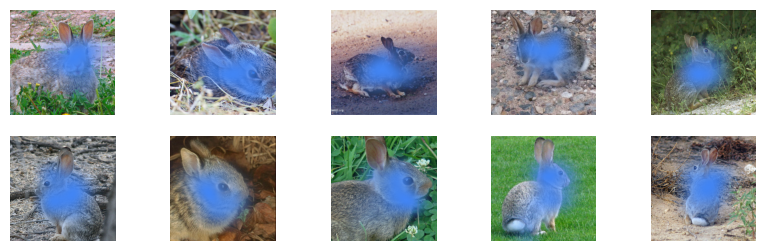

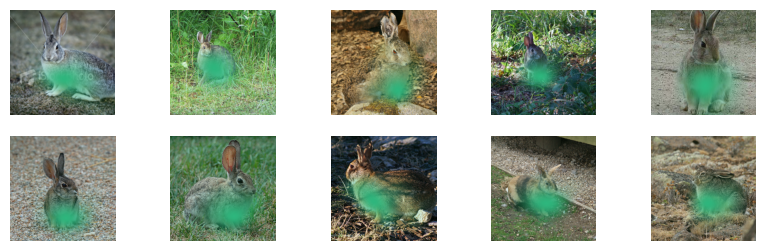

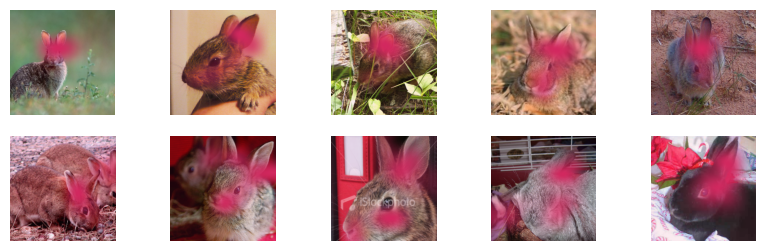

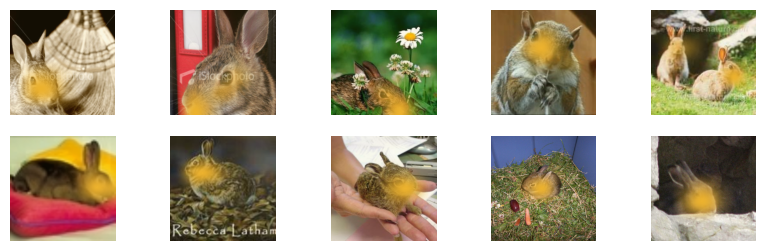

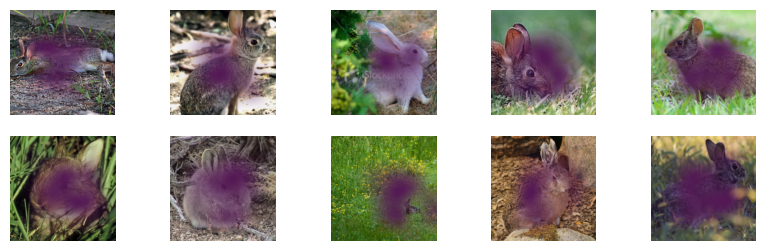

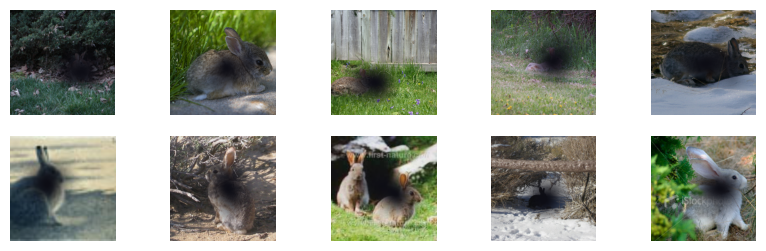

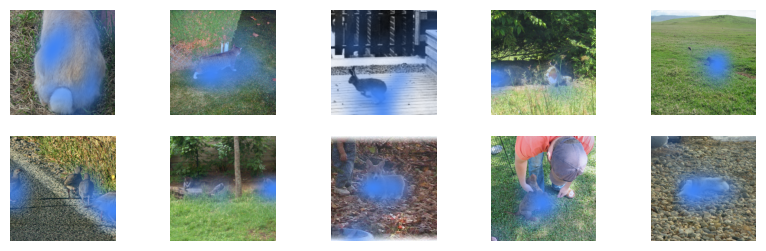

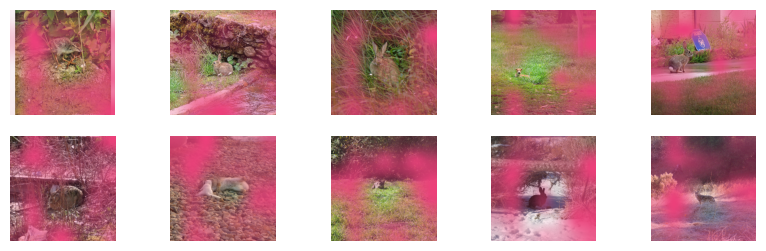

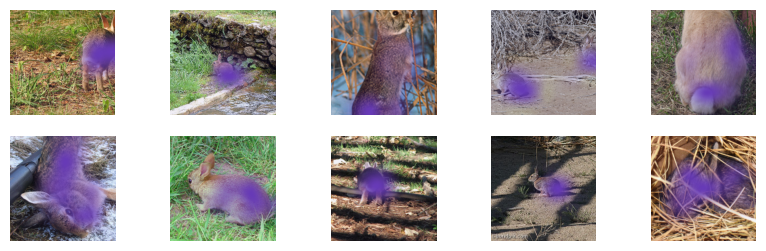

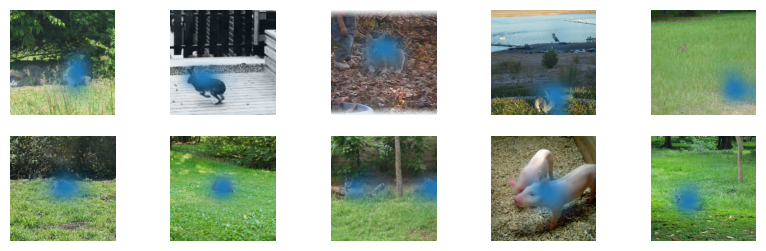

In [ ]:
for concept_id in range(10):
  set_size(10, 3)
  overlay_top_heatmaps(Imgs, Z_heatmaps, concept_id, cmap=cmaps[concept_id], alpha=1.0)
  plt.show()
  print('')

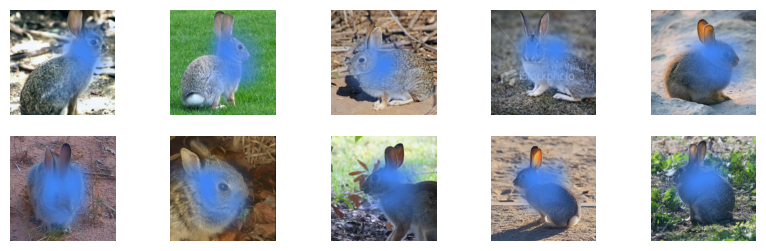

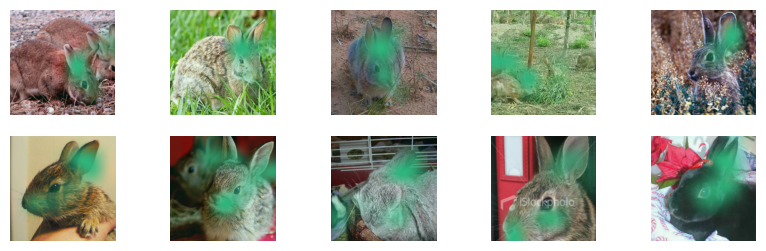

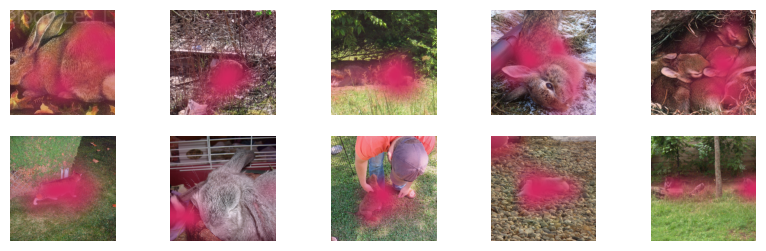

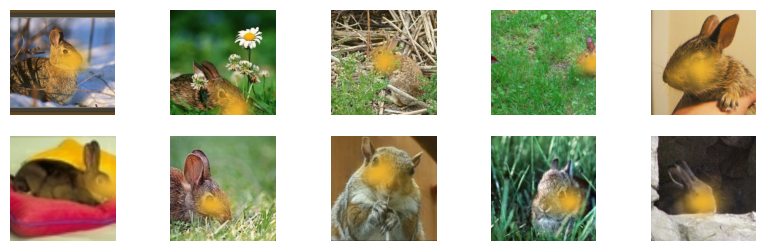

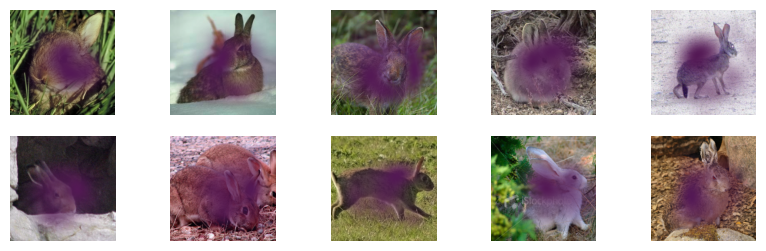

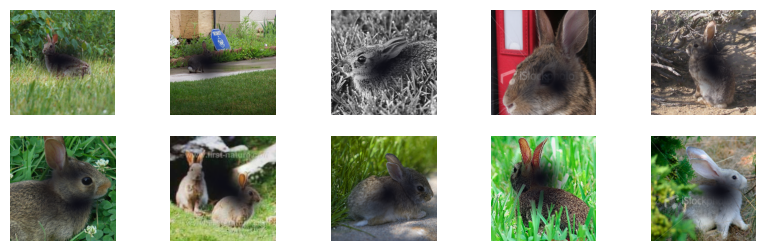

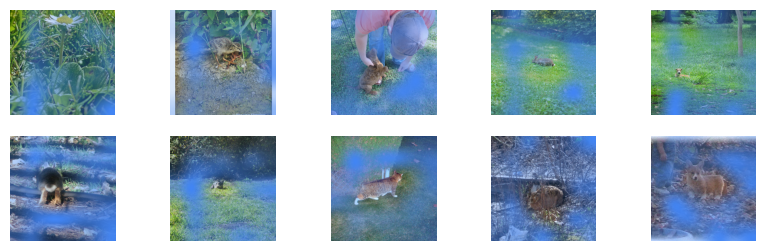

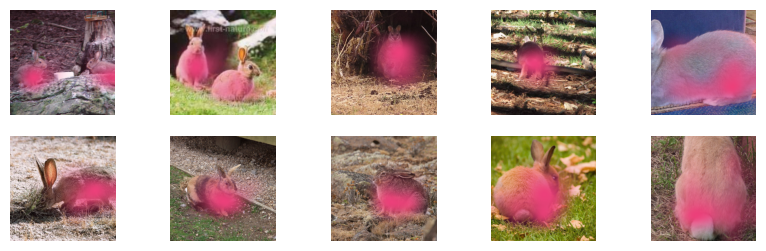

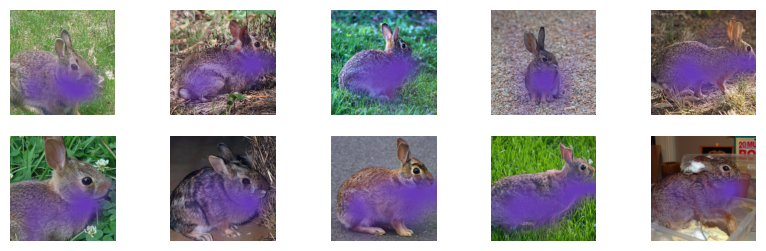

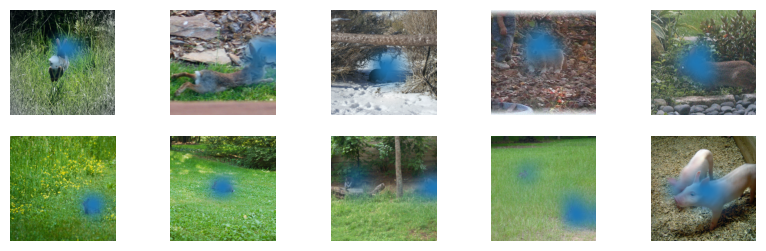

In [ ]:
nmf = NMF(10)

A_flatten = rearrange(A, 'n c h w -> (n h w) c')

Z = nmf.fit_transform(A_flatten)
D = nmf.components_

Z_heatmaps = rearrange(Z, '(n h w) r -> n h w r', n=len(X), h=7, w=7)

for concept_id in range(10):
  set_size(10, 3)
  overlay_top_heatmaps(Imgs, Z_heatmaps, concept_id, cmap=cmaps[concept_id], alpha=1.0)
  plt.show()
  print('')

In [ ]:
# most important are E(Z) * W'
# W' is D @ W.T
W = model.fc.weight.detach().cpu().numpy()
W_p = D @ W.T
Importance = np.mean(Z, 0) * W_p[:, 330] # rabbit class
Importance.shape

(10,)

Importance score 1.9561402


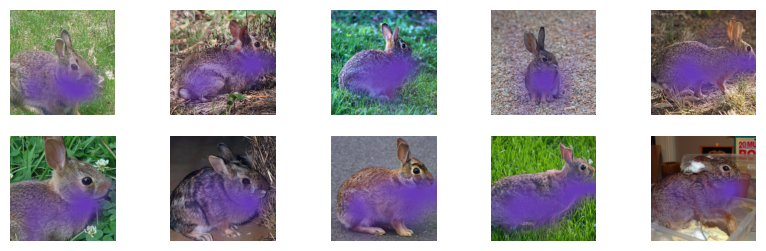

Importance score 1.6043425


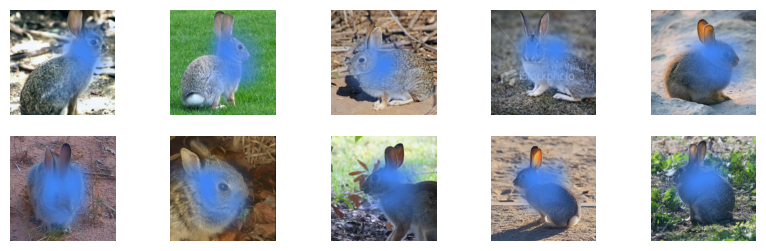

Importance score 1.1634518


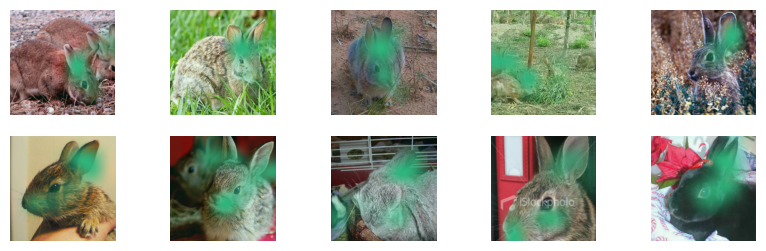

Importance score 0.91962475


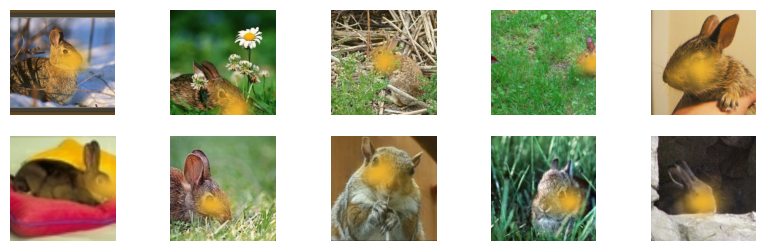

Importance score 0.6285231


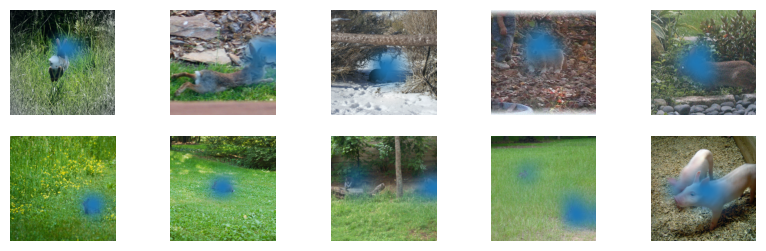

Importance score 0.5564614


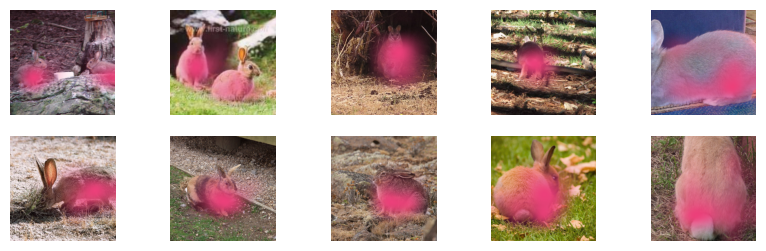

Importance score 0.40950736


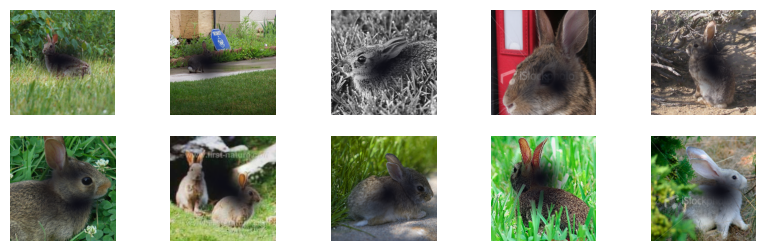

Importance score -0.10660225


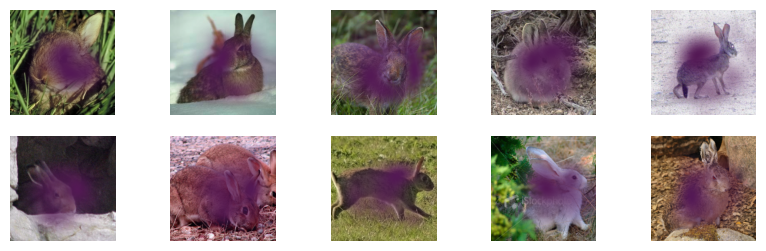

Importance score -0.14196986


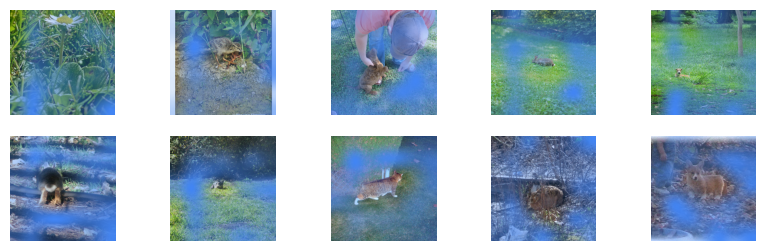

Importance score -0.21626492


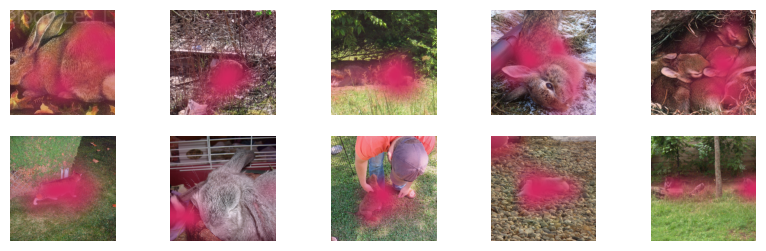

In [ ]:
for concept_id in np.argsort(Importance)[::-1]:
  set_size(10, 3)
  overlay_top_heatmaps(Imgs, Z_heatmaps, concept_id, cmap=cmaps[concept_id], alpha=1.0)
  print('Importance score', Importance[concept_id])
  plt.show()


In [ ]:
!pip install -q horama

100%|██████████| 256/256 [00:23<00:00, 11.06it/s]


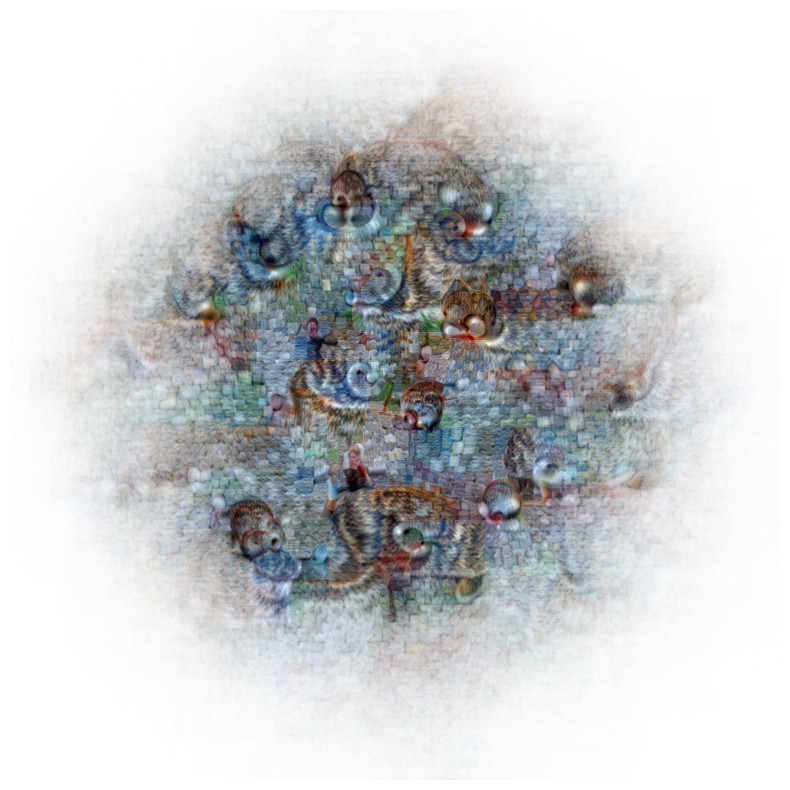

In [ ]:
D_t = torch.tensor(D).cuda().T
concept_id = np.argmax(Importance)

def objective(images):
  activations = model.forward_features(images).mean((2,3))
  concept_values_approx = activations @ D_t
  score = concept_values_approx[:, concept_id].mean()
  return score

set_size(10, 10)
image1, alpha1 = maco(objective, image_size=2048, total_steps=256)
plot_maco(image1, alpha1)
plt.show()

In [ ]:
# watch badly classified point and show their concepts ?
predictions = []

for batch in batcher(X, 32):
  batch = transform(batch)
  batch_predictions = model(batch).argmax(1)
  predictions.append(batch_predictions.detach().cpu().numpy())

predictions = np.concatenate(predictions, axis=0)
predictions[:30]

array([330, 331, 330, 330, 330, 330, 330, 330, 330, 330, 330, 330, 331,
       331, 330, 330, 330, 330, 330, 330, 269, 330, 330, 330, 330, 330,
       372, 330, 343, 330])

In [ ]:
bad_pred = np.argwhere(predictions != 330).flatten()
bad_pred

array([  1,  12,  13,  20,  26,  28,  32,  36,  52,  54,  55,  72,  88,
        91,  92,  93, 104, 106, 116, 119, 122, 127, 132, 134, 143, 148,
       150, 160, 161, 169, 171, 173, 175, 179, 192, 193, 203, 205, 207,
       222, 234, 235, 245, 263, 264, 269, 280, 282, 285, 286, 293, 294,
       297])

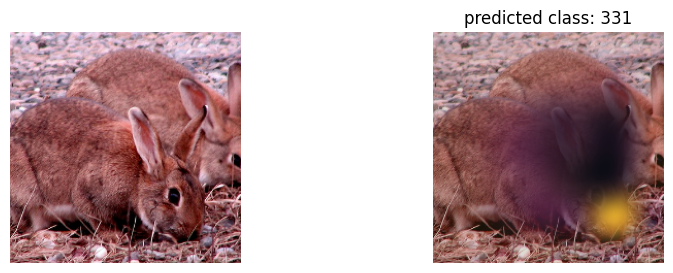

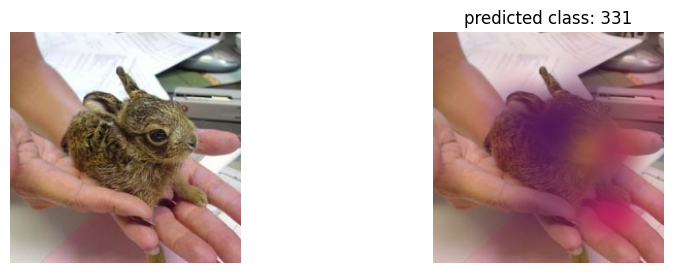

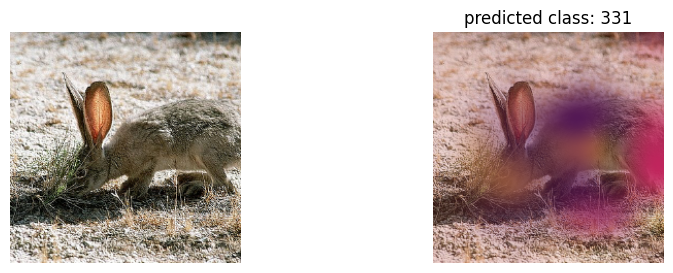

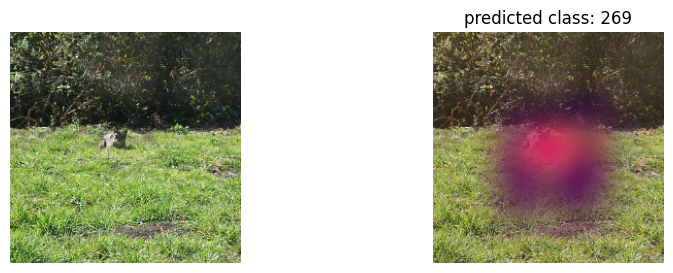

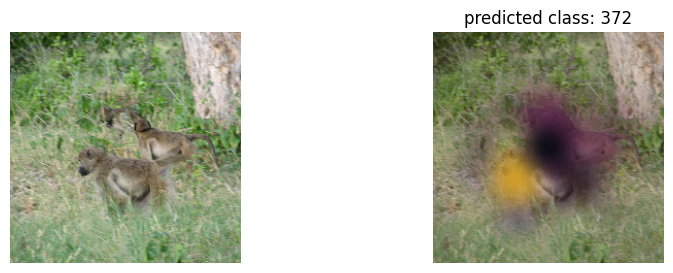

...

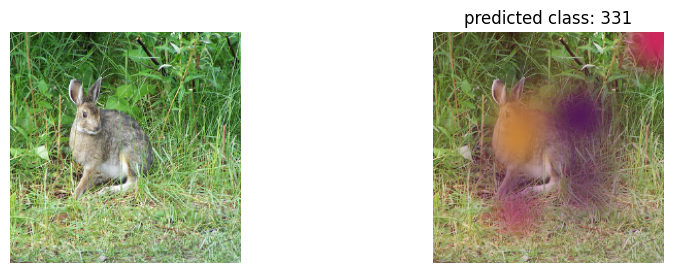

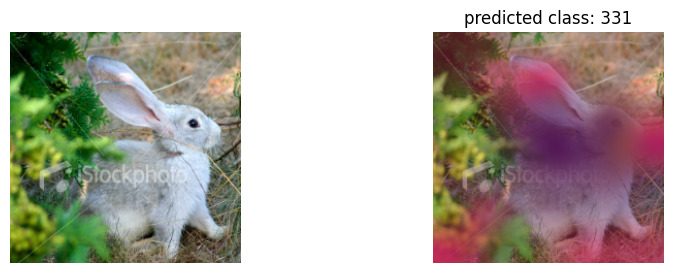

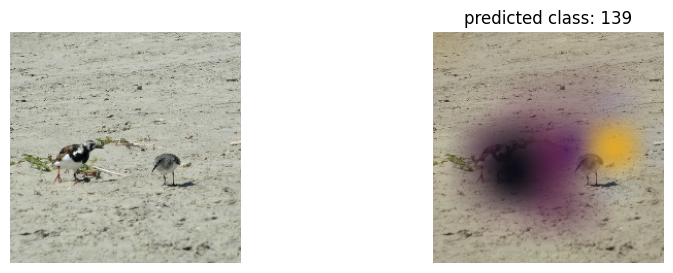

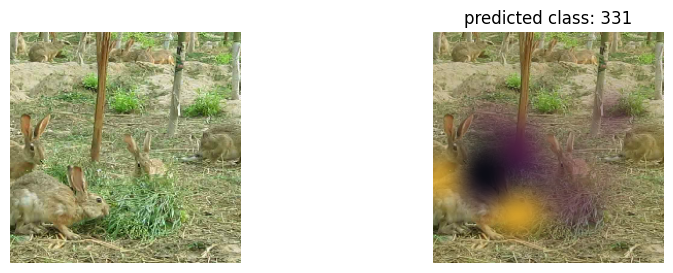

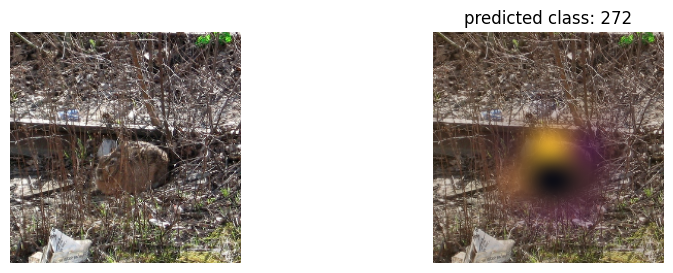

In [ ]:
for i in bad_pred:
  plt.subplot(1, 2, 1)
  show(Imgs[i])
  plt.subplot(1, 2, 2)
  show(Imgs[i])
  top_concepts = np.argsort(Z_heatmaps[i].mean((1,2)))[::-1]
  for concept_id in top_concepts[:3]:
    set_size(10, 3)
    show(cv2.resize(Z_heatmaps[i, :, :, concept_id], (Imgs.shape[1], Imgs.shape[2]), interpolation=cv2.INTER_CUBIC), cmap=cmaps[concept_id])
  plt.title('predicted class: ' + str(predictions[i]))
  plt.show()
